<a href="https://colab.research.google.com/github/suyogk23/ipl-prediction-models-STARC/blob/main/tsProphet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
df=pd.read_csv('ipl_data_s.csv')
df.dropna(inplace=True)
df.head()

,mid,date,venue,bat_team,bowl_team,batsman,bowler,runs,wickets,overs,runs_last_5,wickets_last_5,striker,non-striker,total
0,1,18-04-2008,M Chinnaswamy Stadium,Kolkata Knight Riders,Royal Challengers Bangalore,SC Ganguly,P Kumar,1,0,0.1,1,0,0,0,222
1,1,18-04-2008,M Chinnaswamy Stadium,Kolkata Knight Riders,Royal Challengers Bangalore,SC Ganguly,P Kumar,1,0,0.2,1,0,0,0,222
2,1,18-04-2008,M Chinnaswamy Stadium,Kolkata Knight Riders,Royal Challengers Bangalore,SC Ganguly,P Kumar,2,0,0.2,2,0,0,0,222
3,1,18-04-2008,M Chinnaswamy Stadium,Kolkata Knight Riders,Royal Challengers Bangalore,SC Ganguly,P Kumar,2,0,0.3,2,0,0,0,222
4,1,18-04-2008,M Chinnaswamy Stadium,Kolkata Knight Riders,Royal Challengers Bangalore,SC Ganguly,P Kumar,2,0,0.4,2,0,0,0,222


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76014 entries, 0 to 76013
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   mid             76014 non-null  int64  
 1   date            76014 non-null  object 
 2   venue           76014 non-null  object 
 3   bat_team        76014 non-null  object 
 4   bowl_team       76014 non-null  object 
 5   batsman         76014 non-null  object 
 6   bowler          76014 non-null  object 
 7   runs            76014 non-null  int64  
 8   wickets         76014 non-null  int64  
 9   overs           76014 non-null  float64
 10  runs_last_5     76014 non-null  int64  
 11  wickets_last_5  76014 non-null  int64  
 12  striker         76014 non-null  int64  
 13  non-striker     76014 non-null  int64  
 14  total           76014 non-null  int64  
dtypes: float64(1), int64(8), object(6)
memory usage: 8.7+ MB


In [ ]:
!pip install prophet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from prophet.plot import plot_plotly, plot_components_plotly
from prophet import Prophet

In [ ]:
df=df[['overs','runs']]

<Axes: xlabel='overs'>

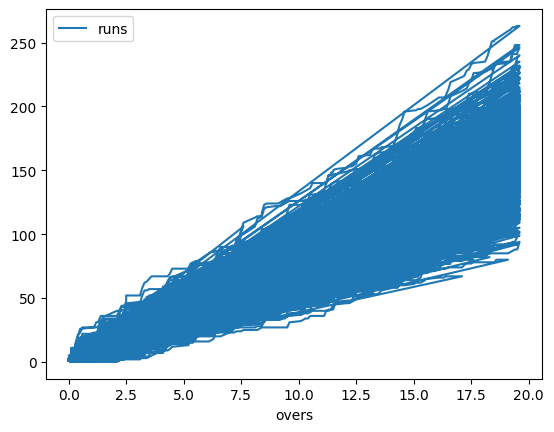

In [ ]:
df.plot(x='overs',y='runs')

prophet requires date column to predict time series, hence mapped dates to overs for prediction model to work properly

In [ ]:
starting_date = pd.to_datetime('2000-01-01')  # Replace with your desired starting date
frequency = 'D'  # Replace with the desired frequency ('D' for daily, 'W' for weekly, etc.)

# Generate synthetic dates
num_rows = len(df)  # Number of rows in your DataFrame
synthetic_dates = pd.date_range(start=starting_date, periods=num_rows, freq=frequency)

# Add the synthetic dates as a column in the DataFrame
df['dateToOvers'] = synthetic_dates

# Display the modified DataFrame
print(df)

       overs  runs dateToOvers
0        0.1     1  2000-01-01
1        0.2     1  2000-01-02
2        0.2     2  2000-01-03
3        0.3     2  2000-01-04
4        0.4     2  2000-01-05
...      ...   ...         ...
76009   19.2   121  2208-02-09
76010   19.3   127  2208-02-10
76011   19.4   128  2208-02-11
76012   19.5   129  2208-02-12
76013   19.6   129  2208-02-13

[76014 rows x 3 columns]


In [ ]:
newDf=df[['dateToOvers','runs']]
newDf.head()

,dateToOvers,runs
0,2000-01-01,1
1,2000-01-02,1
2,2000-01-03,2
3,2000-01-04,2
4,2000-01-05,2


In [ ]:
newDf.columns = ['ds','y']
newDf.tail()

,ds,y
76009,2208-02-09,121
76010,2208-02-10,127
76011,2208-02-11,128
76012,2208-02-12,129
76013,2208-02-13,129


In [ ]:
# Create a dictionary mapping overs to dates
dateToOvers_mapping = dict(zip(df['overs'], df['dateToOvers']))
# Create a new column 'date_mapped' by mapping overs to dates
df['date_mapped'] = df['overs'].map(dateToOvers_mapping)
print(df)

       overs  runs dateToOvers date_mapped
0        0.1     1  2000-01-01  2207-10-12
1        0.2     1  2000-01-02  2207-10-13
2        0.2     2  2000-01-03  2207-10-13
3        0.3     2  2000-01-04  2207-10-14
4        0.4     2  2000-01-05  2207-10-15
...      ...   ...         ...         ...
76009   19.2   121  2208-02-09  2208-02-09
76010   19.3   127  2208-02-10  2208-02-10
76011   19.4   128  2208-02-11  2208-02-11
76012   19.5   129  2208-02-12  2208-02-12
76013   19.6   129  2208-02-13  2208-02-13

[76014 rows x 4 columns]


<Axes: xlabel='ds'>

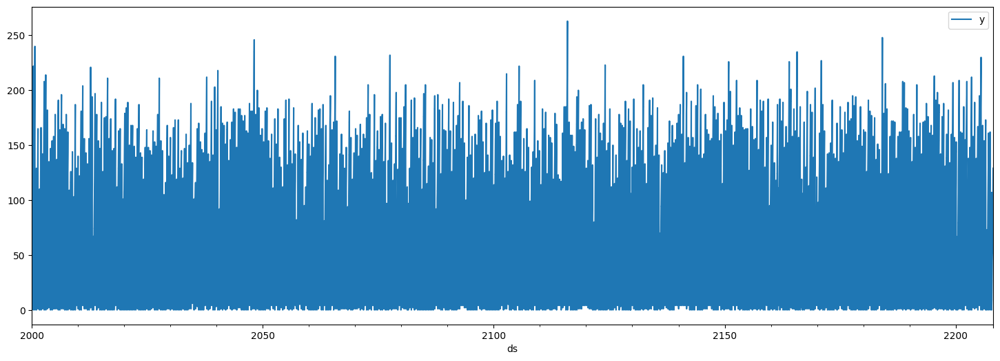

In [ ]:
newDf.plot(x='ds',y='y',figsize=(18,6))

In [ ]:
# from sklearn.model_selection import train_test_split

# # Assuming you have a DataFrame called 'df'
# # Splitting the data into training and testing sets
# train, test = train_test_split(newDf, test_size=0.2, random_state=42)

# # Checking the shape of the train and test sets
# print("Train set shape:", train.shape)
# print("Test set shape:", test.shape)


Train set shape: (60811, 2)
Test set shape: (15203, 2)


In [ ]:
train = newDf.iloc[:60811]
test = newDf.iloc[60812:]

In [ ]:
m = Prophet()
m.fit(train)
#future prediction bound = 30
future = m.make_future_dataframe(periods=15203) #MS for monthly, H for hourly
forecast = m.predict(future)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpyuf0rdsa/b4wz5u5q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpyuf0rdsa/1ds7501b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41358', 'data', 'file=/tmp/tmpyuf0rdsa/b4wz5u5q.json', 'init=/tmp/tmpyuf0rdsa/1ds7501b.json', 'output', 'file=/tmp/tmpyuf0rdsa/prophet_modele78co267/prophet_model-20230624173346.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
17:33:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
17:34:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
76009,2208-02-09,88.694009,19.572651,153.012624
76010,2208-02-10,88.824951,23.872670,152.195401
76011,2208-02-11,88.633607,26.463847,156.871678
76012,2208-02-12,88.839118,29.410384,149.696730
76013,2208-02-13,88.694462,28.145071,149.505809


In [ ]:
test.tail()

,ds,y
76009,2208-02-09,121
76010,2208-02-10,127
76011,2208-02-11,128
76012,2208-02-12,129
76013,2208-02-13,129


In [ ]:
#prophet visualization
plot_plotly(m ,forecast)

In [ ]:
plot_components_plotly(m, forecast)

In [ ]:
#testing the model
from statsmodels.tools.eval_measures import rmse
predictions = forecast.iloc[60812:]['yhat']
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))
print("Mean Value of Test Dataset:", test['y'].mean())
#test metrics suggest model is highly inaccurate

Root Mean Squared Error between actual and  predicted values:  50.69028820348567
Mean Value of Test Dataset: 77.73181160373635


RMSE too high-model inaccurate

In [ ]:
train.tail()

,ds,y
60806,2166-06-25,39
60807,2166-06-26,39
60808,2166-06-27,41
60809,2166-06-28,45
60810,2166-06-29,46


In [ ]:
forecast.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60841 entries, 0 to 60840
Data columns (total 19 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   ds                          60841 non-null  datetime64[ns]
 1   trend                       60841 non-null  float64       
 2   yhat_lower                  60841 non-null  float64       
 3   yhat_upper                  60841 non-null  float64       
 4   trend_lower                 60841 non-null  float64       
 5   trend_upper                 60841 non-null  float64       
 6   additive_terms              60841 non-null  float64       
 7   additive_terms_lower        60841 non-null  float64       
 8   additive_terms_upper        60841 non-null  float64       
 9   weekly                      60841 non-null  float64       
 10  weekly_lower                60841 non-null  float64       
 11  weekly_upper                60841 non-null  float64   

In [ ]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
60836,2166-07-25,80.688730,12.131950,138.803225,80.688730,80.688730,-1.435364,-1.435364,-1.435364,0.135686,0.135686,0.135686,-1.571051,-1.571051,-1.571051,0.0,0.0,0.0,79.253366
60837,2166-07-26,80.689345,11.977082,144.715921,80.689345,80.689345,-1.343571,-1.343571,-1.343571,0.009779,0.009779,0.009779,-1.353350,-1.353350,-1.353350,0.0,0.0,0.0,79.345774
60838,2166-07-27,80.689960,14.677930,146.029725,80.689960,80.689960,-1.167907,-1.167907,-1.167907,-0.061749,-0.061749,-0.061749,-1.106158,-1.106158,-1.106158,0.0,0.0,0.0,79.522054
60839,2166-07-28,80.690575,21.871618,145.431185,80.690575,80.690575,-0.871809,-0.871809,-0.871809,-0.041719,-0.041719,-0.041719,-0.830091,-0.830091,-0.830091,0.0,0.0,0.0,79.818766
60840,2166-07-29,80.691190,18.118096,139.036403,80.691190,80.691190,-0.574987,-0.574987,-0.574987,-0.048787,-0.048787,-0.048787,-0.526199,-0.526199,-0.526199,0.0,0.0,0.0,80.116204
